In [18]:
# Libraries imports
import numpy as np
import matplotlib.pyplot as plt
import cv2, skimage, os, sys
from collections import deque

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [19]:
# Local imports
from src import saliancy_map as sm
from src import utils
from src import optimization as opt
from src import database as db
from manippulating_saliency_main import phi, update_taus, manipulate_saliency

print('Model loaded.')

Model loaded.


# Initialisation

In [20]:
# User Input
#image_path = './data/debug/easy_apple_small.jpg'
#mask_path = './data/debug/easy_apple_small_mask.jpg'
image_path = './data/object_enhancement/029_in.jpg'
mask_path = './data/object_enhancement/masks/029_mask.jpg'
desired_output_image_path = './data/object_enhancement/029_out.jpg'

delta_s = 0.8

# Constants
EPSILON = 1e-3

# Modular Definitions
compute_saliency_map = sm.tempsal_saliency
minimize_J = opt.minimize_J_global_poisson
compute_database = db.compute_location_database


Image size: (341, 512, 3)
Mask size: (171, 256)


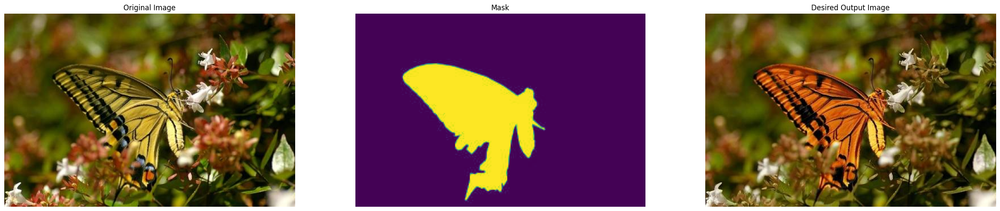

In [21]:
# Read the image
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print("Image size:", img.shape)

mask_image = cv2.imread(mask_path)
mask_image = cv2.cvtColor(mask_image, cv2.COLOR_BGR2GRAY)[:,:]
print("Mask size:", mask_image.shape)

#show desired output image
desired_output_image = cv2.imread(desired_output_image_path)
desired_output_image = cv2.cvtColor(desired_output_image, cv2.COLOR_BGR2RGB)




utils.display_images([img, mask_image,desired_output_image], titles=['Original Image', 'Mask','Desired Output Image'])

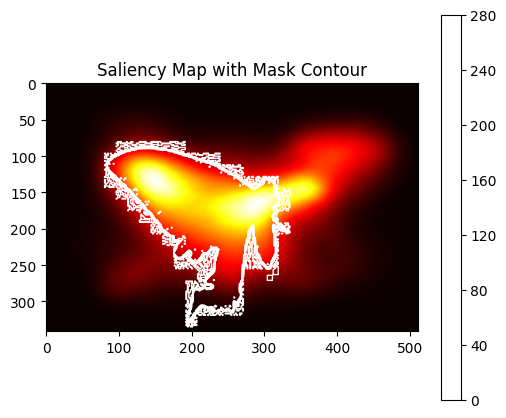

Foreground mean: 0.1603
Background mean: 0.2845
Foreground max: 1.0000
Background max: 0.8619
Foreground pixel count: 169824
Background pixel count: 4768


In [46]:
# Normalize saliency map
s_map = s_map.astype(np.float32)
s_map /= (s_map.max() + 1e-8)

# Show saliency map with mask contour
plt.figure(figsize=(6, 5))
plt.imshow(s_map, cmap='hot')
plt.contour(mask_image_resized, colors='white', linewidths=1)
plt.title('Saliency Map with Mask Contour')
plt.colorbar()
plt.show()

# Foreground/background stats
foreground = s_map[mask_image_resized > 0]
background = s_map[mask_image_resized == 0]

print(f"Foreground mean: {foreground.mean():.4f}")
print(f"Background mean: {background.mean():.4f}")
print(f"Foreground max: {foreground.max():.4f}")
print(f"Background max: {background.max():.4f}")
print(f"Foreground pixel count: {len(foreground)}")
print(f"Background pixel count: {len(background)}")


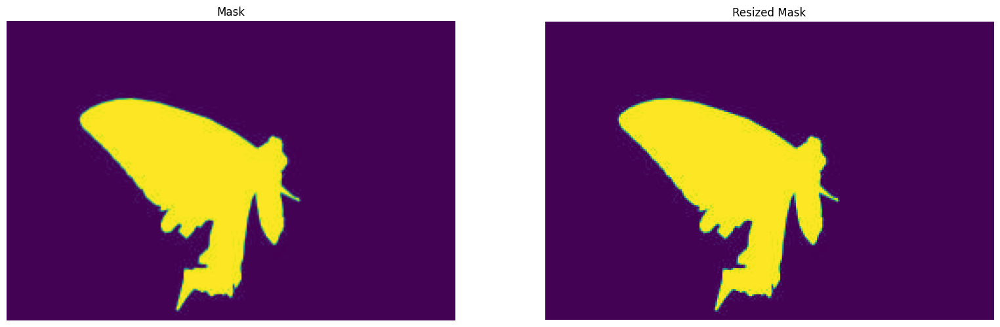

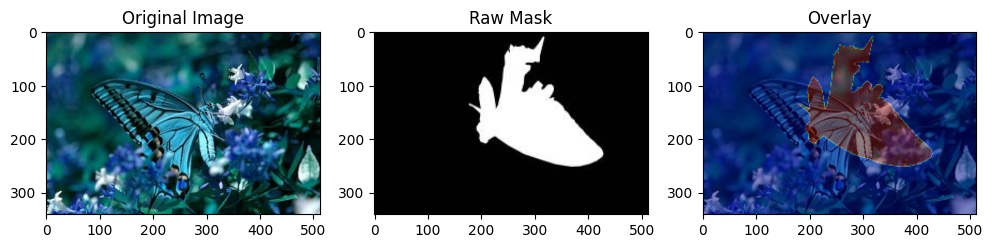

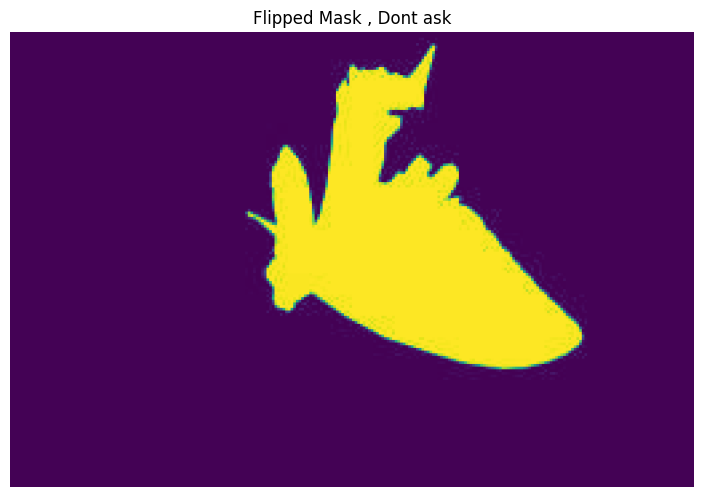

In [42]:


mask_image_resized = cv2.resize(mask_image, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)

#show the mask and resized mask
utils.display_images([mask_image, mask_image_resized], titles=['Mask', 'Resized Mask'])


mask_image_resized = cv2.flip(mask_image_resized, 1)  # 1 means horizontal
mask_image_resized = cv2.flip(mask_image_resized, 0)


plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(img[..., ::-1])  # Convert to RGB if using cv2
plt.title("Original Image")

plt.subplot(1, 3, 2)
plt.imshow(mask_image_resized, cmap='gray')
plt.title("Raw Mask")

plt.subplot(1, 3, 3)
plt.imshow(img[..., ::-1])
plt.imshow(mask_image_resized, cmap='jet', alpha=0.5)
plt.title("Overlay")
plt.show()
assert img.shape[:2] == mask_image_resized.shape[:2], "Image and mask must match in size"


#show the flipped mask
utils.display_images([mask_image_resized], titles=['Flipped Mask , Dont ask'])






In [45]:
# reset mask_image_resized = mask_image
mask_image_resized = cv2.resize(mask_image, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)

# Saliency Manipulation

In [24]:
# Initialize tau +/-
tau_positive = 0.2
tau_negative = 0.05
prev_tau_positive = tau_positive
prev_tau_negative = tau_negative

J_in = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
J_out = np.array([])

#### Partial Algorithm

You must do the iteration yourself :) 

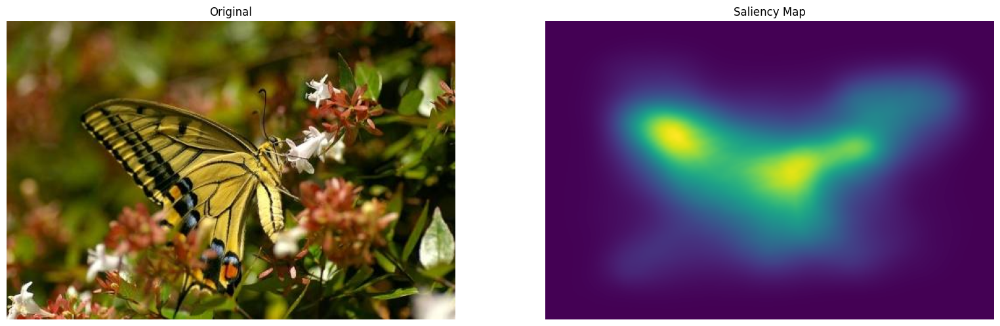

In [25]:
# Compute Saliency
s_map = compute_saliency_map(J_in)

utils.display_images([img, s_map], ['Original', 'Saliency Map'])

assert s_map.shape[:2] == mask_image_resized.shape

DB+ size: 48542, DB- size: 87690


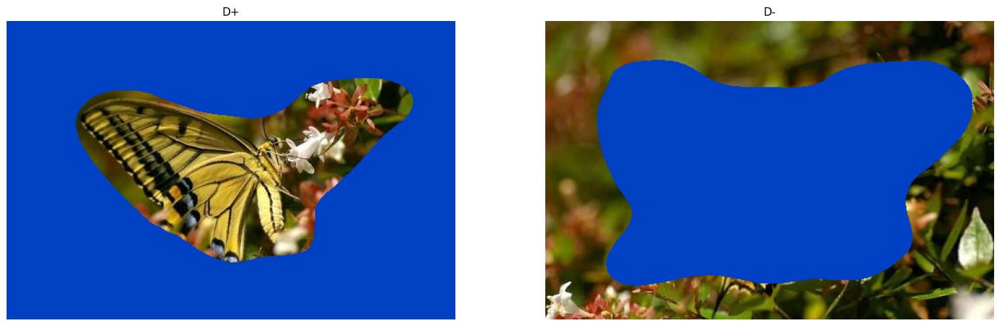

In [26]:
# DB update
D_positive, D_negative = compute_database(tau_positive, tau_negative, J_in, s_map)
print(f"DB+ size: {D_positive.shape[0]}, DB- size: {D_negative.shape[0]}")

# Construct and display the database's images
I_D_positive, I_D_negative = db.compute_image_database(J_in, D_positive, D_negative)

utils.display_images([I_D_positive, I_D_negative], ['D+', 'D-'])

Search-and-vote

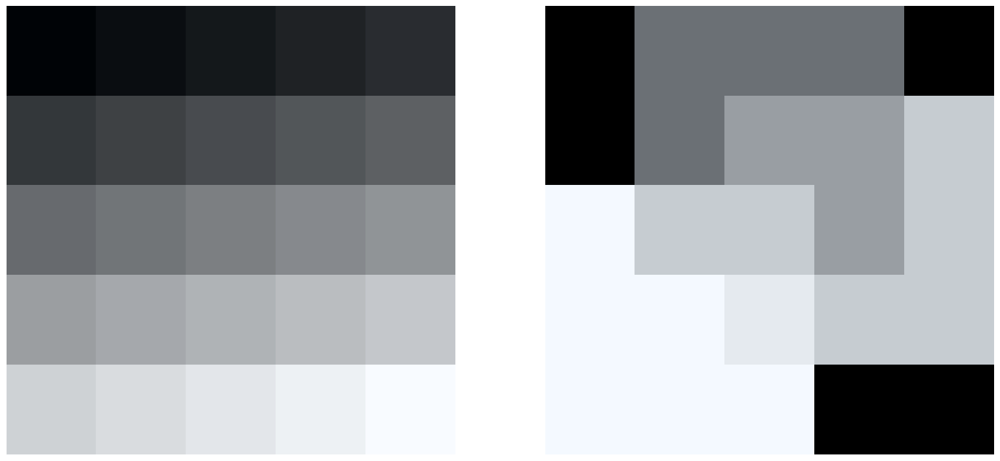

In [27]:
a = np.arange(75).reshape((5,5,3)) / 74
searched_patches_map = np.zeros((5,5,4))
patch_size=5
p_idxs = np.indices((3,3)).reshape(2, -1).T -1
for x in range(1,a.shape[0]-1, 2):
    for y in range(1, a.shape[1]-1, 2):
        x = np.random.randint(1,a.shape[0]-1)
        y = np.random.randint(1,a.shape[1]-1)
        p = a[x-1:x+2, y-1:y+2]
        s = searched_patches_map[x-1:x+2, y-1:y+2]

        # new_mean (per pixel) = temp_mean * N/(N+p*p) + p_mean / N+p*p
        n_plus_p2 = (s[:,:,3] + patch_size**2)
        s[:,:,:-1] *= (s[:,:,3] / n_plus_p2)[:,:,None]
        s[:,:,:-1] += np.ones_like(p) * p.sum(axis=(0,1)) / n_plus_p2[:,:,None]
        s[:,:,-1] = n_plus_p2.copy()
        

b = searched_patches_map[:,:,0:3]
b /= b.max()
utils.display_images([a,b])

In [28]:
# PATCHMATHC = SEARCH

patch_size = 7
stride = 3

width, height, _ = J_in.shape
radius = patch_size // 2

# Pad the image so that the patch don't overlap. (dont look, just know it works)
J_paded = np.stack([np.pad(J_in[:,:,i], radius, mode="reflect") for i in range(3)]).transpose(1,2,0)

# Create the mapping from a pixel location to (the current mean of the overlapping patches, number of elements. 
searched_patches_map = np.zeros((J_paded.shape[0], J_paded.shape[1], 4)) # 4 = (curr_r_mean, curr_g_mean, curr_b_mean, # seen pixels)

# Loop through all centers of each patch
for x in range(0, width, stride):
    for y in range(0, height, stride):
        # Because of pading, (x, y) actualy reprensent top left corner of patch 
        patch = J_paded[x:x+patch_size, y:y+patch_size]

        if mask_image_resized[x, y] > 0 and len(D_positive) > 0:
            # Inside the mask (more salient)
            best_match = opt.find_best_match(patch, D_positive, J_paded)

        elif len(D_negative) > 0:
            # Outside the mask (less salient)
            best_match = opt.find_best_match(patch, D_negative, J_paded)
        else:
            best_match = patch  # If DB is empty keep orignal patch
        
        # VOTING STEP (but done on the fly)

        s = searched_patches_map[x:x+patch_size, y:y+patch_size]

        # TODO: filter out what is not in the "corect" given region
        # new_mean (per pixel) = temp_mean * N/(N+p*p) + p_mean / N+p*p
        n_plus_p2 = (s[:,:,3] + patch_size**2)
        s[:,:,:-1] *= (s[:,:,3] / n_plus_p2)[:,:,None]
        s[:,:,:-1] += np.ones_like(best_match) * best_match.sum(axis=(0,1)) / n_plus_p2[:,:,None]
        s[:,:,-1] = n_plus_p2.copy()

# Unpad the image
J_patched_padded = searched_patches_map[:, :, :-1]

# Put back in range [0, 255]
J_patched_padded = np.floor(J_patched_padded).astype(np.uint8)

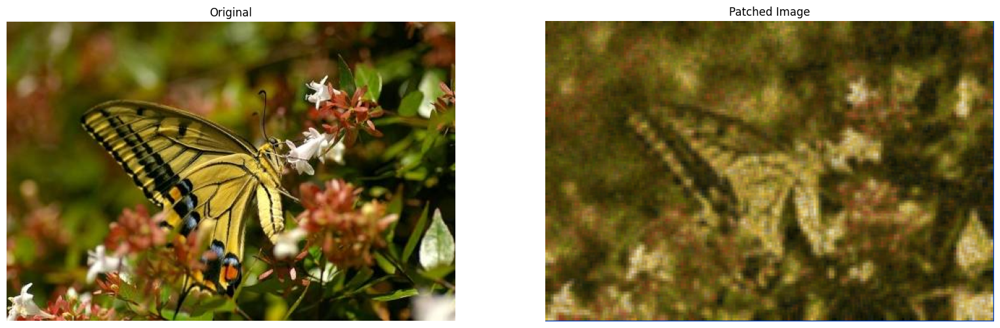

In [29]:
# Display patchMatch
J_patched_rgb = cv2.cvtColor(J_patched_padded, cv2.COLOR_Lab2RGB)
utils.display_images([img, J_patched_rgb], ['Original', 'Patched Image'])

Recursive patchy


In [30]:
from collections import deque
import numpy as np

def get_flat_layer_index(x, y, patch_size):
    return (x % patch_size) + patch_size * (y % patch_size)

def extract_patch(image, x, y, patch_size):
    r = patch_size // 2
    return image[x - r:x + r + 1, y - r:y + r + 1]

def in_bounds(x, y, shape, patch_size):
    r = patch_size // 2
    return r <= x < shape[0] - r and r <= y < shape[1] - r

def vote_patch(searched_patches_map, patch, x, y):
    """Patch-wise vote with real spatial patch blending"""
    r = patch.shape[0] // 2
    region = searched_patches_map[x - r:x + r + 1, y - r:y + r + 1]

    n = region[:, :, 3:4] + 1
    region[:, :, :3] = (region[:, :, :3] * region[:, :, 3:4] + patch) / n
    region[:, :, 3:4] = n

def bfs_patchmatch(x0, y0, J, mask, patch_size, D_positive, D_negative, image_layers, max_depth=999, mode='auto'):
    H, W, _ = J.shape
    visited = np.zeros((H, W), dtype=bool)
    queue = deque()
    queue.append((x0, y0, 0))

    while queue:
        x, y, depth = queue.popleft()
        if not in_bounds(x, y, J.shape[:2], patch_size) or visited[x, y] or depth > max_depth:
            continue

        visited[x, y] = True
        patch = extract_patch(J, x, y, patch_size)

        if mode == 'auto':
            if mask[x, y] > 0 and len(D_positive) > 0:
                best = opt.find_best_match(patch, D_positive, J)
            elif len(D_negative) > 0:
                best = opt.find_best_match(patch, D_negative, J)
            else:
                best = patch
        else:
            db = D_positive if mode == 'pos' else D_negative
            best = opt.find_best_match(patch, db, J)

        layer_id = get_flat_layer_index(x, y, patch_size)
        vote_patch(image_layers[layer_id], best, x, y)

        for dx, dy in [(-patch_size, 0), (patch_size, 0), (0, -patch_size), (0, patch_size)]:
            queue.append((x + dx, y + dy, depth + 1))

def merge_layers(image_layers):
    H, W, _ = image_layers[0].shape
    final = np.zeros((H, W, 3), dtype=np.float32)
    weight = np.zeros((H, W, 1), dtype=np.float32)

    for layer in image_layers:
        final += layer[:, :, :3]
        weight += layer[:, :, 3:4]

    final = final / np.maximum(weight, 1e-5)
    return np.clip(final, 0, 255).astype(np.uint8)








In [40]:


from scipy.sparse.linalg import cg
from scipy.sparse.linalg import LinearOperator
import cv2
import numpy as np
def blend_with_original_unvoted(J_patchmatched, J_original_rgb, vote_weights, threshold=1e-3):
    """
    Fill in areas of J_patchmatched with J_original_rgb where vote_weights are too low.
    """
    fallback_mask = vote_weights < threshold  # (H, W, 1)
    fallback_mask_3c = np.repeat(fallback_mask, 3, axis=2)  # Make (H, W, 3)

    return np.where(fallback_mask_3c, J_original_rgb, J_patchmatched)


def PoissonStuff(original_rgb, modified_rgb, lambda_factor=0.005):
    """
    Applies screened Poisson blending to each RGB channel
    to blend modified_rgb into original_rgb.

    Args:
        original_rgb: The input image before modification (RGB, uint8)
        modified_rgb: The patchmatched image (RGB, uint8 or float32)
        lambda_factor: Balance between data term and smoothness

    Returns:
        Blended image (RGB, uint8)
    """
    # Ensure float32 format
    original_rgb = original_rgb.astype(np.float32)
    modified_rgb = modified_rgb.astype(np.float32)
    
    H, W, _ = original_rgb.shape
    result = np.zeros_like(original_rgb)

    def make_poisson_operator(n, m):
        """Returns a linear operator that applies the screened Poisson matrix."""
        def matvec(x):
            x_reshaped = x.reshape((n, m)).astype(np.float64)
            lap = cv2.Laplacian(x_reshaped, cv2.CV_64F)
            return (lambda_factor * x_reshaped - lap).flatten()
        return LinearOperator((n*m, n*m), matvec=matvec)

    # Solve Poisson per channel
    for c in range(3):
        # b = λ * f_modified - Δf_original
        laplacian = cv2.Laplacian(original_rgb[:, :, c].astype(np.float64), cv2.CV_64F)
        b = lambda_factor * modified_rgb[:, :, c].astype(np.float64) - laplacian

        A = make_poisson_operator(H, W)
        x, _ = cg(A, b.flatten(), maxiter=200)
        result[:, :, c] = x.reshape((H, W))

    return np.clip(result, 0, 255).astype(np.uint8)


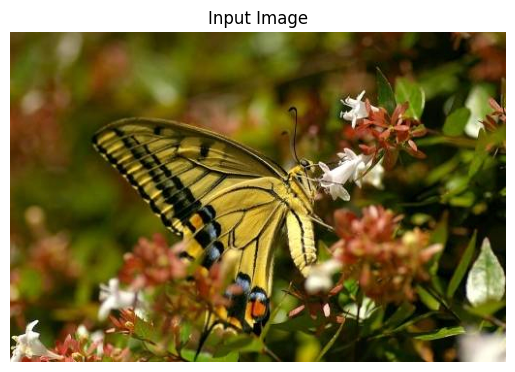

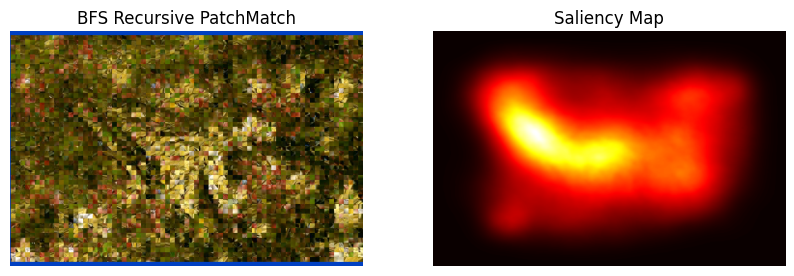

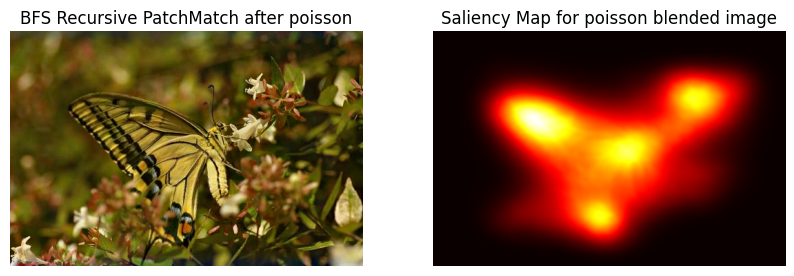

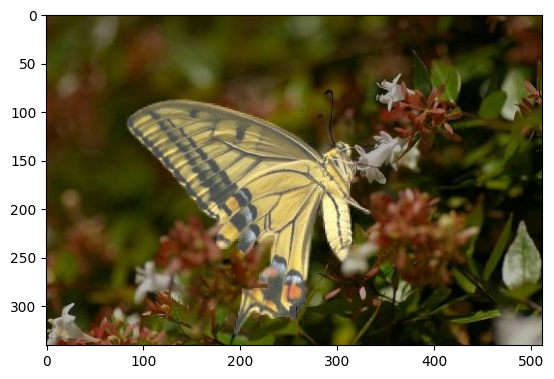

In [32]:
# Parameters
PATCH_SIZE = 7
MAX_DEPTH = 999
J_in= cv2.cvtColor(img, cv2.COLOR_RGB2Lab) 
#show img
plt.imshow(cv2.cvtColor(J_in, cv2.COLOR_Lab2RGB))
plt.title("Input Image")
plt.axis("off")
plt.show()


# Input image: assume J_in = Lab image and mask_image binary mask
H, W, _ = J_in.shape
num_layers = PATCH_SIZE ** 2

# Initialize image_layers
image_layers = [np.zeros((H, W, 4), dtype=np.float32) for _ in range(num_layers)]

# Start BFS from center
center_x, center_y = H // 2, W // 2
bfs_patchmatch(center_x, center_y, J_in, mask_image_resized, PATCH_SIZE, D_positive, D_negative, image_layers, max_depth=MAX_DEPTH)

# Merge result
J_merged = merge_layers(image_layers)
J_rgb_unblended = cv2.cvtColor(J_merged, cv2.COLOR_Lab2RGB)

# === Border fix before Poisson ===
border = PATCH_SIZE // 2 + 1
original_rgb = img.copy() 
J_rgb_unblended[:border, :] = original_rgb[:border, :]
J_rgb_unblended[-border:, :] = original_rgb[-border:, :]
J_rgb_unblended[:, :border] = original_rgb[:, :border]
J_rgb_unblended[:, -border:] = original_rgb[:, -border:]

# Poisson blend
J_rgb = PoissonStuff(original_rgb, J_rgb_unblended)



# Show result
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(J_merged, cv2.COLOR_Lab2RGB))
plt.title("BFS Recursive PatchMatch")
plt.axis("off")

plt.subplot(1, 2, 2)
s_map = compute_saliency_map(cv2.cvtColor(J_merged, cv2.COLOR_Lab2RGB))
plt.imshow(s_map, cmap="hot")
plt.title("Saliency Map")
plt.axis("off")
plt.show()
#
# Show result
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(J_rgb)
plt.title("BFS Recursive PatchMatch after poisson")
plt.axis("off")

plt.subplot(1, 2, 2)
s_map = compute_saliency_map(J_rgb)
plt.imshow(s_map, cmap="hot")
plt.title("Saliency Map for poisson blended image")
plt.axis("off")
plt.show()

plt.imshow(img)
plt.imshow(mask_image_resized, alpha=0.3, cmap='gray')


--- Iteration 1 ---


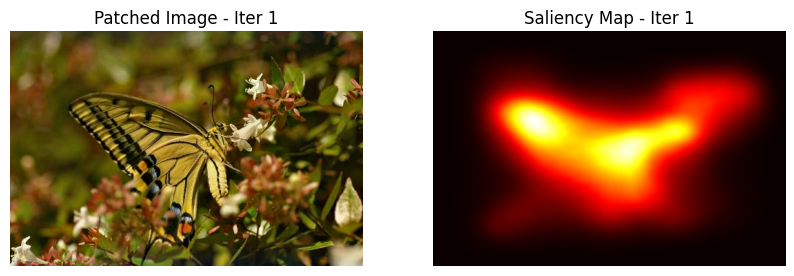

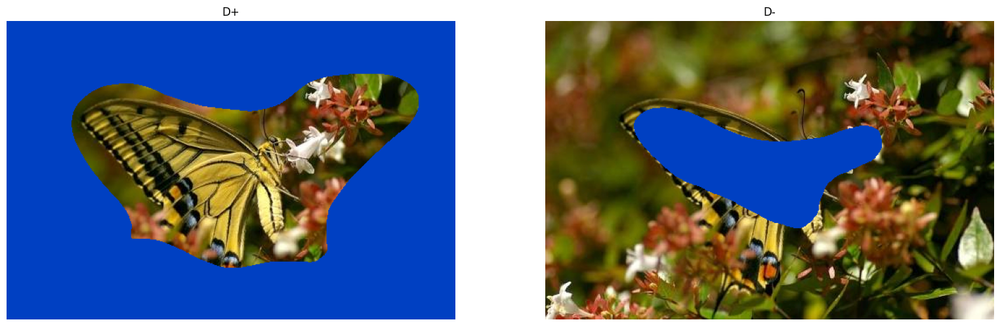

Saliency Foreground: 0.1591, Saliency Background: 0.2496
Current contrast: -0.0905, Desired contrast: 0.6000
New tau_positive: 0.2191, tau_negative: 0.4655
--- Iteration 2 ---


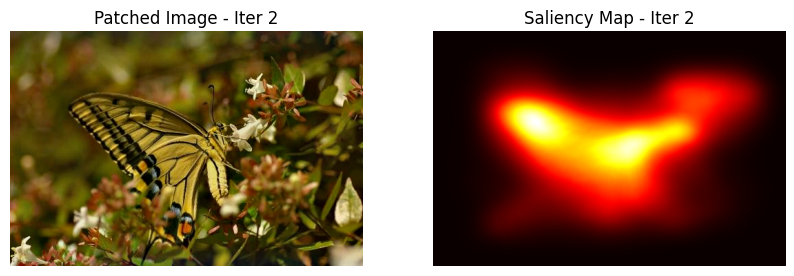

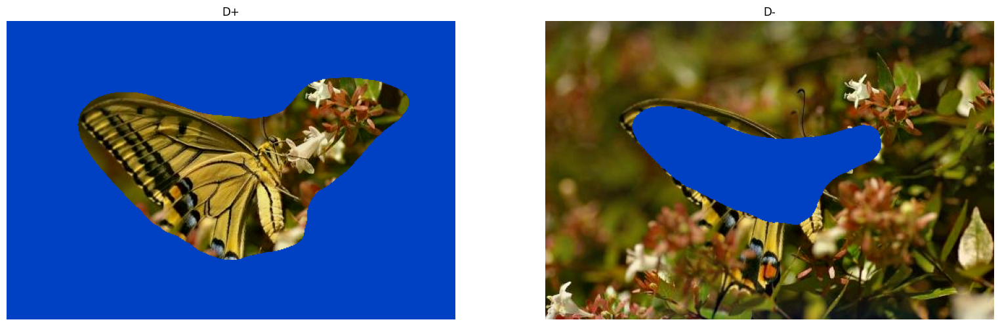

Saliency Foreground: 0.1606, Saliency Background: 0.2528
Current contrast: -0.0921, Desired contrast: 0.6000
New tau_positive: 0.2883, tau_negative: 0.4309
--- Iteration 3 ---


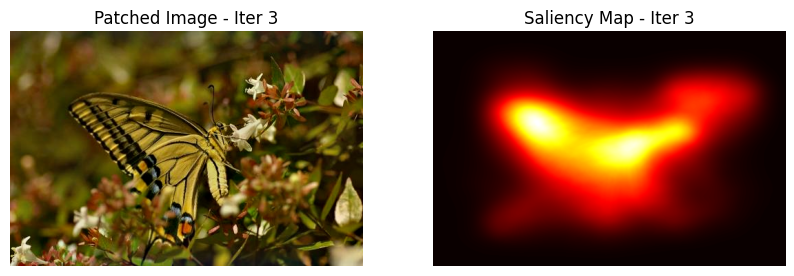

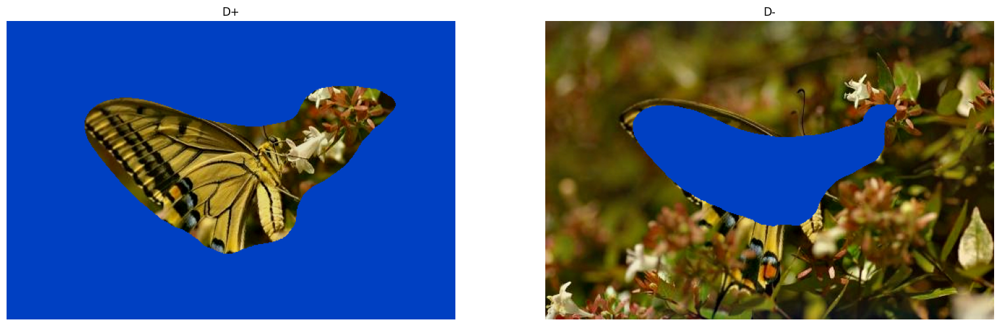

Saliency Foreground: 0.1621, Saliency Background: 0.2588
Current contrast: -0.0967, Desired contrast: 0.6000
New tau_positive: 0.3579, tau_negative: 0.3960
--- Iteration 4 ---


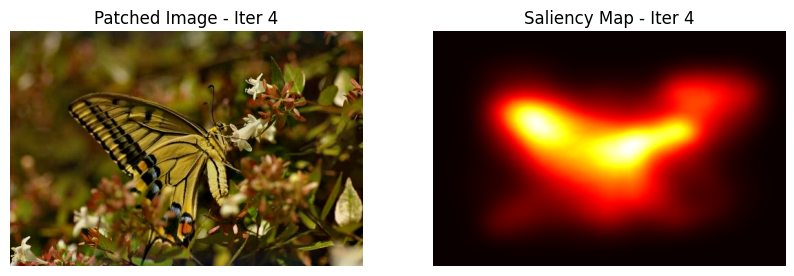

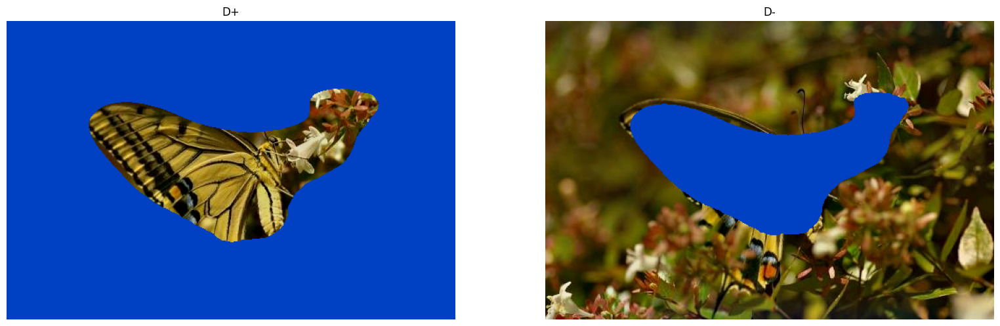

Saliency Foreground: 0.1599, Saliency Background: 0.2509
Current contrast: -0.0911, Desired contrast: 0.6000
New tau_positive: 0.4270, tau_negative: 0.3615
--- Iteration 5 ---


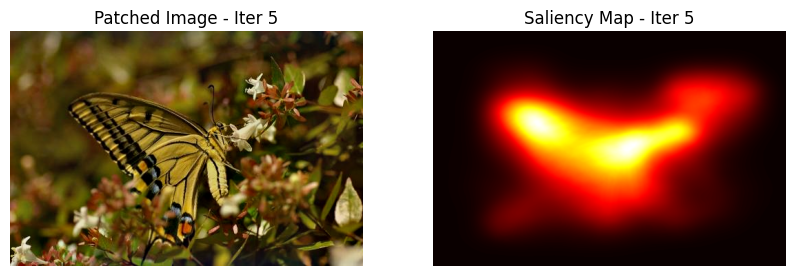

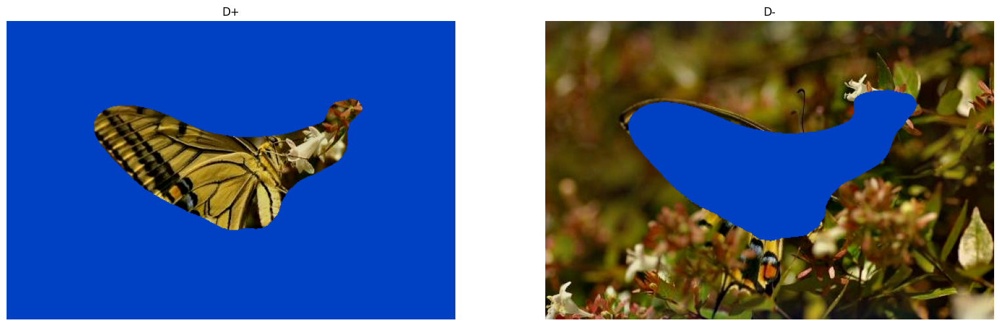

Saliency Foreground: 0.1580, Saliency Background: 0.2501
Current contrast: -0.0921, Desired contrast: 0.6000
New tau_positive: 0.4963, tau_negative: 0.3269
--- Iteration 6 ---


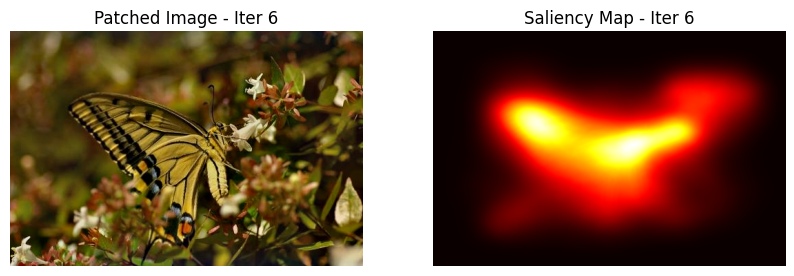

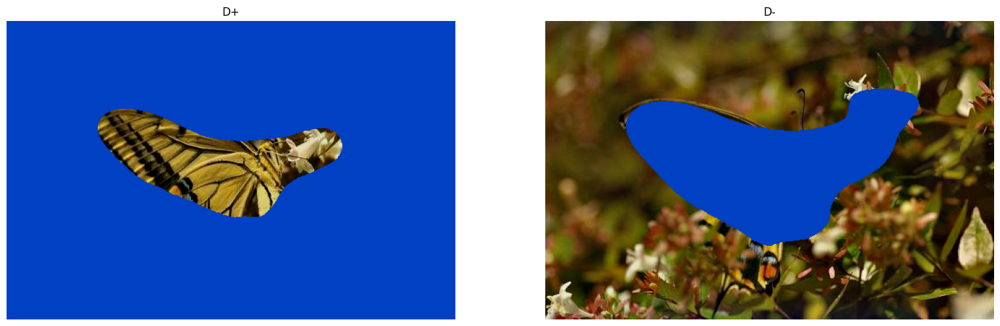

Saliency Foreground: 0.1640, Saliency Background: 0.2571
Current contrast: -0.0931, Desired contrast: 0.6000
New tau_positive: 0.5656, tau_negative: 0.2922
--- Iteration 7 ---


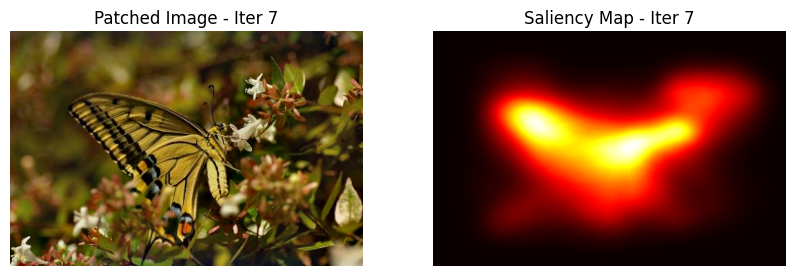

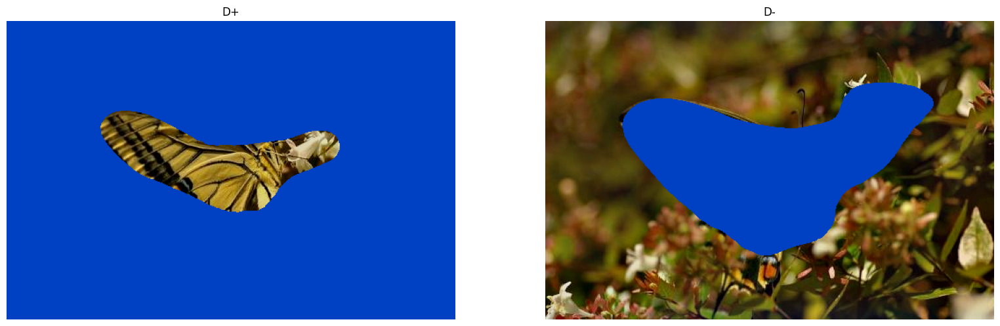

Saliency Foreground: 0.1630, Saliency Background: 0.2536
Current contrast: -0.0907, Desired contrast: 0.6000
New tau_positive: 0.6346, tau_negative: 0.2577
--- Iteration 8 ---


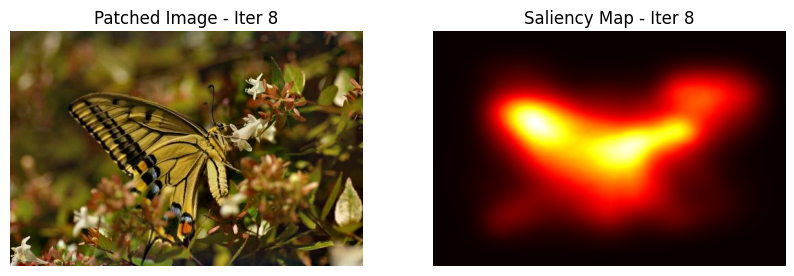

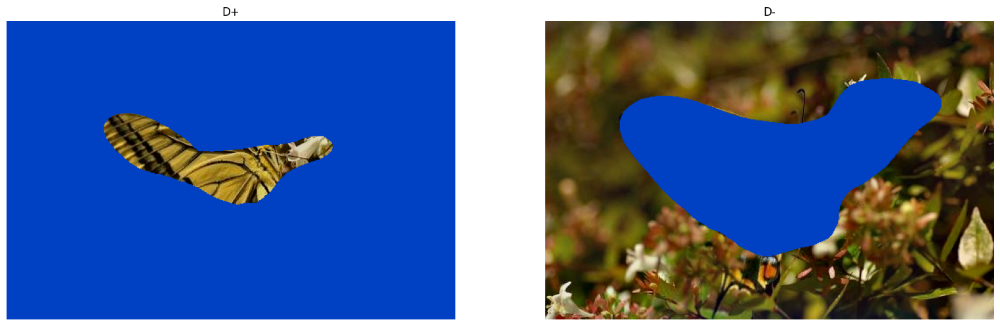

Saliency Foreground: 0.1596, Saliency Background: 0.2529
Current contrast: -0.0934, Desired contrast: 0.6000
New tau_positive: 0.7040, tau_negative: 0.2230
--- Iteration 9 ---


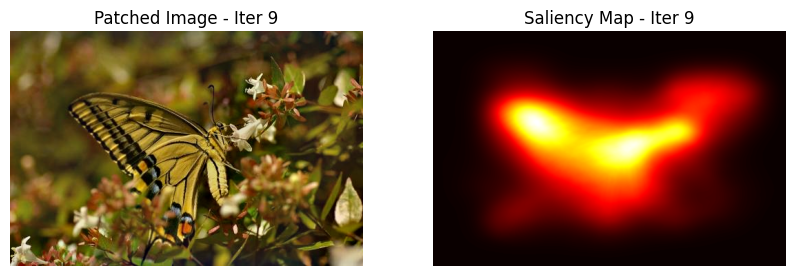

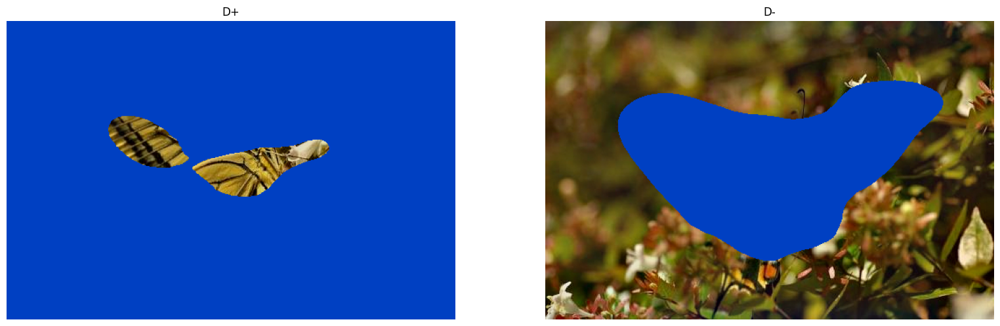

Saliency Foreground: 0.1629, Saliency Background: 0.2548
Current contrast: -0.0918, Desired contrast: 0.6000
New tau_positive: 0.7732, tau_negative: 0.1884
--- Iteration 10 ---


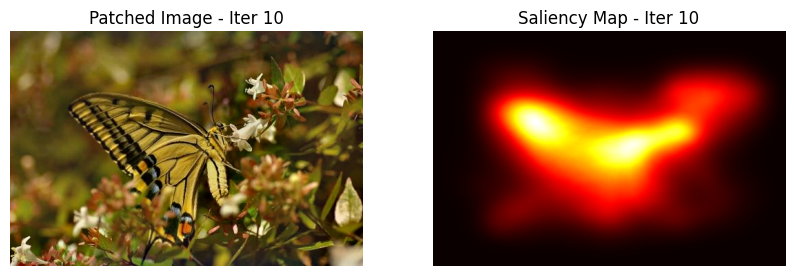

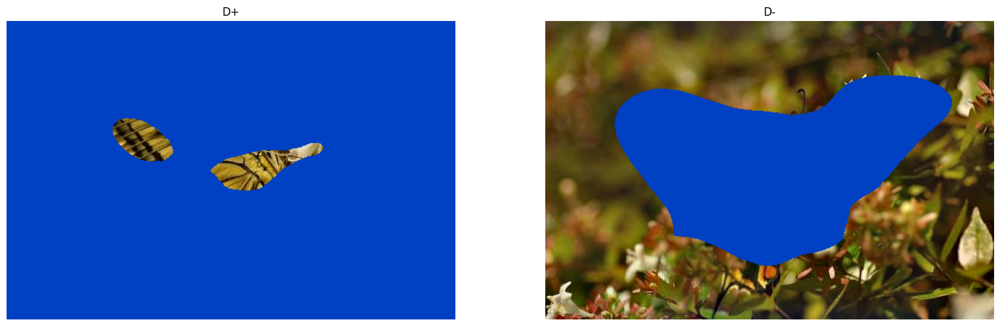

Saliency Foreground: 0.1612, Saliency Background: 0.2538
Current contrast: -0.0926, Desired contrast: 0.6000
New tau_positive: 0.8424, tau_negative: 0.1538


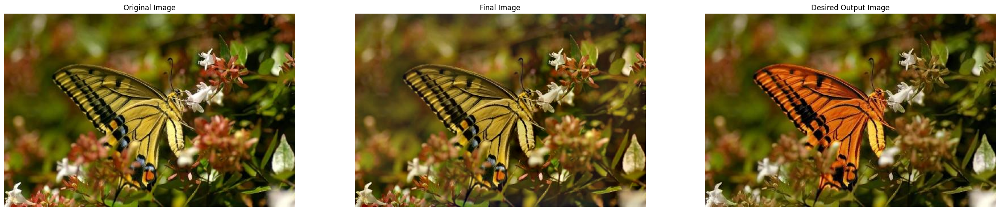

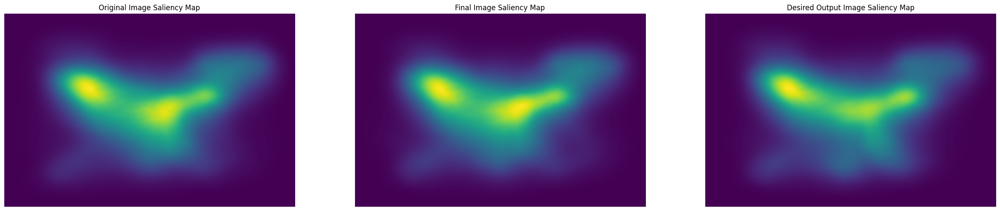

In [43]:
# === RUN BLOCK for Multiple Iterations with BFS Recursive PatchMatch (Fixed Version) ===
PATCH_SIZE = 7
MAX_DEPTH = 999
run_times = 10
tau_positive = 0.15
tau_negative = 0.5
learning_rate_positive = 0.1
learning_rate_negative = 0.05
delta_s = 0.6
# Convert input image to Lab space
J_in = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
# Compute saliency map
s_map = compute_saliency_map(J_in)

for i in range(run_times):
    print(f"--- Iteration {i+1} ---")
    #convert input image to RGB
    

    # Build D+ and D- patch coordinate databases
    D_positive, D_negative = compute_database(tau_positive, tau_negative, J_in, s_map)

    # Allocate image layers
    H, W, _ = J_in.shape
    image_layers = [np.zeros((H, W, 4), dtype=np.float32) for _ in range(PATCH_SIZE ** 2)]

    # Run recursive PatchMatch with BFS spread
    center_x, center_y = H // 2, W // 2
    bfs_patchmatch(center_x, center_y, J_in, mask_image_resized, PATCH_SIZE, D_positive, D_negative, image_layers, max_depth=MAX_DEPTH)

    # Merge result and convert to RGB for Poisson
    J_merged = merge_layers(image_layers)
    J_rgb_unblended = cv2.cvtColor(J_merged.astype(np.uint8), cv2.COLOR_Lab2RGB)
    

    # === Border fix before Poisson ===
    border = PATCH_SIZE // 2 + 1
    original_rgb = img.copy()
    J_rgb_unblended[:border, :] = original_rgb[:border, :]
    J_rgb_unblended[-border:, :] = original_rgb[-border:, :]
    J_rgb_unblended[:, :border] = original_rgb[:, :border]
    J_rgb_unblended[:, -border:] = original_rgb[:, -border:]

    # Poisson blend
    J_rgb = PoissonStuff(original_rgb, J_rgb_unblended)
    #     maybe dont do everything in rgb and just do border stuff in lab?????
    # Display images
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(J_rgb)
    plt.title(f'Patched Image - Iter {i+1}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(s_map, cmap='hot')
    plt.title(f'Saliency Map - Iter {i+1}')
    plt.axis('off')
    plt.show()
    
    I_D_positive, I_D_negative = db.compute_image_database(J_in, D_positive, D_negative)

    utils.display_images([I_D_positive, I_D_negative], ['D+', 'D-'])

    # Update for next iteration
    J_in = cv2.cvtColor(J_rgb.astype(np.uint8), cv2.COLOR_RGB2Lab)
    
    s_map = compute_saliency_map(J_in)  # Already RGB here

    # Saliency feedback update
    assert s_map.shape[:2] == mask_image_resized.shape, "Mismatch between saliency map and mask."
    saliency_foreground = np.mean(s_map[mask_image_resized > 0])
    saliency_background = np.mean(s_map[mask_image_resized == 0])
    current_contrast = saliency_foreground - saliency_background
    #print forground and background saliency
    print(f"Saliency Foreground: {saliency_foreground:.4f}, Saliency Background: {saliency_background:.4f}")
    adjustment_positive = np.abs(current_contrast - delta_s) * learning_rate_positive
    adjustment_negative = np.abs(current_contrast - delta_s) * learning_rate_negative
    tau_positive += adjustment_positive
    tau_negative -= adjustment_negative
    tau_positive = min(max(tau_positive, 0), 1)
    tau_negative = min(max(tau_negative, 0), 1)
    print(f"Current contrast: {current_contrast:.4f}, Desired contrast: {delta_s:.4f}")
    print(f"New tau_positive: {tau_positive:.4f}, tau_negative: {tau_negative:.4f}")
    

# Final display
utils.display_images([img, J_rgb, desired_output_image], ['Original Image', 'Final Image', 'Desired Output Image'])

s_map_original = compute_saliency_map(cv2.cvtColor(img, cv2.COLOR_RGB2Lab))
s_map_final = compute_saliency_map(cv2.cvtColor(J_rgb, cv2.COLOR_RGB2Lab))
s_map_desired = compute_saliency_map(cv2.cvtColor(desired_output_image, cv2.COLOR_RGB2Lab))



utils.display_images([s_map_original, s_map_final, s_map_desired], ['Original Image Saliency Map', 'Final Image Saliency Map', 'Desired Output Image Saliency Map'])


In [110]:
# Compute saliency maps
sal_before = compute_saliency_map(img)
sal_after = compute_saliency_map(J_rgb)

# Compute mean saliency inside and outside mask
s_before_fg = np.mean(sal_before[mask_image > 0])
s_before_bg = np.mean(sal_before[mask_image == 0])
s_after_fg = np.mean(sal_after[mask_image > 0])
s_after_bg = np.mean(sal_after[mask_image == 0])

print("Before: ΔS =", round(s_before_fg - s_before_bg, 4))
print("After:  ΔS =", round(s_after_fg - s_after_bg, 4))

Before: ΔS = 0.267
After:  ΔS = 0.2787


Poisson Screening

In [31]:
poisson_padded = opt.screen_poisson(J_paded, J_patched_padded, lambda_factor=5.)

# un-pad the image
J_out = np.floor(poisson_padded[radius:width+radius, radius:height+radius]).astype(np.uint8)

error: OpenCV(4.11.0) D:/a/opencv-python/opencv-python/opencv/modules/imgproc/src/filter.simd.hpp:3252: error: (-213:The function/feature is not implemented) Unsupported combination of source format (=1), and destination format (=6) in function 'cv::opt_AVX2::getLinearFilter'


In [13]:
# Display Resutls
J_out_rgb = cv2.cvtColor(J_out, cv2.COLOR_Lab2RGB)
diff = np.abs(img - J_out_rgb).mean(axis=2) / 255
print(diff.min(), diff.max())
utils.display_images([img, J_out_rgb, diff], ['Original', 'Modified Saliency', 'diff'])


error: OpenCV(4.11.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\color.cpp:199: error: (-215:Assertion failed) !_src.empty() in function 'cv::cvtColor'


##### Poisson lambda factor test

In [15]:
poissons = []
lambdas = np.logspace(-5,0, 6) * 5

for l in lambdas:
    poisson_padded = opt.screen_poisson(J_paded, J_patched_padded, lambda_factor=l)

    # un-pad the image
    poissons.append(np.floor(poisson_padded[radius:-radius, radius:-radius]).astype(np.uint8))


error: OpenCV(4.11.0) D:/a/opencv-python/opencv-python/opencv/modules/imgproc/src/filter.simd.hpp:3252: error: (-213:The function/feature is not implemented) Unsupported combination of source format (=1), and destination format (=6) in function 'cv::opt_AVX2::getLinearFilter'


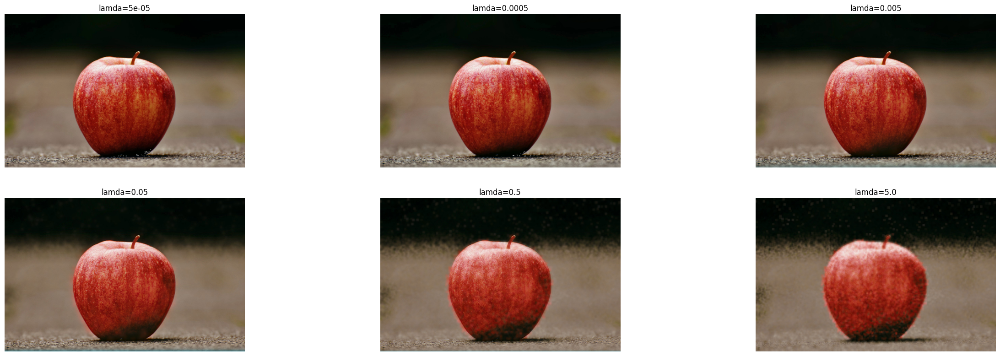

In [106]:
# Display results
utils.display_images([cv2.cvtColor(p, cv2.COLOR_Lab2RGB) for p in poissons], [f'lamda={l}' for l in lambdas])

(un-comment if you want to manualy iterate)

In [ ]:
# # switch the buffers
# temp = J_in.copy()
# J_in = J_out
# J_out = J_in

# # Update tau +/-
# tau_positive, tau_negative = update_taus(tau_positive, tau_negative, s_map, mask_image, delta_s)
# print(f'\n4Tau+: {tau_positive}, Tau-: {tau_negative}')


#### Full Algorithm

In [ ]:
nb_iterations = 1

print("Begin Saliency Manipulation:")

# while compute_criterion(S_J, R, delta_s) > EPSILON:
for x in  range(nb_iterations):
    print(f"Iteration {x}")
    # update the saliency map
    print(" - computing Saliency...")
    s_map = compute_saliency_map(J_in)
    print(" - Done.")

    # DB update
    print(" - computing DB...")
    D_positive, D_negative = compute_database(tau_positive, tau_negative, J_in, s_map)
    print(f" - Done, DB+ size: {D_positive.shape[0]}, DB- size: {D_negative.shape[0]}")
    
    # Construct and display the database's images
    I_D_positive, I_D_negative = db.compute_image_database(J_in, D_positive, D_negative)

    # utils.display_images([S_J, I_D_positive, I_D_negative])

    # update J to minimize the energy function
    print(" - Minimizing function...")
    J_out = minimize_J(J_in, mask_imask_image_resizedmage, D_positive, D_negative)
    print(" - Done.")
    # Update tau +/-
    tau_positive, tau_negative = update_taus(tau_positive, tau_negative, s_map, mask_imask_image_resizedmage, delta_s)

    # switch the buffers (only affect the references so no copy is made)
    temp = J_in.copy()
    J_in = J_out
    J_out = J_in

    # Check if convergence is reached by tau's
    tau_diff = abs(tau_positive - prev_tau_positive) + abs(tau_negative - prev_tau_negative)
    prev_tau_positive, prev_tau_negative = tau_positive, tau_negative
    if tau_diff < EPSILON:
        break

    # print("\033[A\033[K\033[A\033[K\033[A\033[K\033[A\033[K\033[A\033[K\033[A\033[K\033[A\033[K", end="")
    
# Cancel the last input-output exchange
temp = J_in.copy()
J_in = J_out
J_out = J_in

print("Done")
J_out = cv2.cvtColor(J_out, cv2.COLOR_Lab2RGB)

Begin Saliency Manipulation:
Iteration 0
 - computing Saliency...
 - Done.
 - computing DB...
 - Done, DB+ size: 33469, DB- size: 215630
 - Minimizing function...
  - Applying PatchMatch...
  - Applying Poisson Screening... - Done.
Done


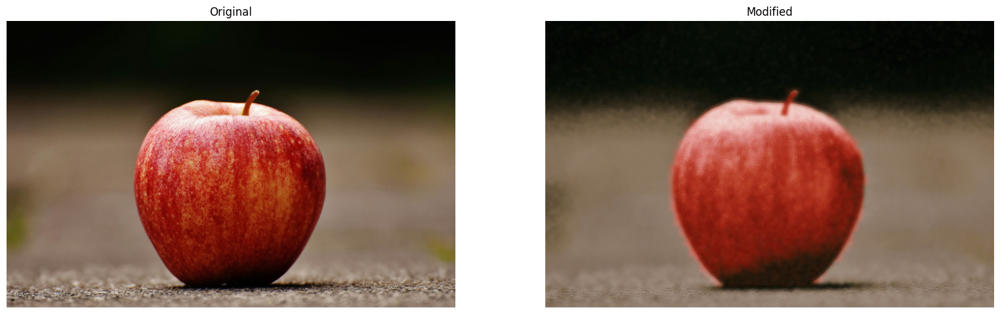

In [118]:
# Display results
utils.display_images([img, J_out], ['Original', 'Modified'])